(300, 451, 3)


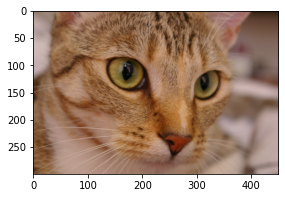

In [ ]:
from skimage import data
import matplotlib.pyplot as plt

hr_image = data.chelsea() # skimage에서 제공하는 예제 이미지를 불러옵니다.
hr_shape = hr_image.shape[:2]

print(hr_image.shape) # 이미지의 크기를 출력합니다.

plt.figure(figsize=(6,3))
plt.imshow(hr_image)

이 고양이 이미지의 크기는 (세로 픽셀 수 x 가로 픽셀 수 x 채널 수) 가 [300 x 451 x 3] 으로 확인되네요. Interpolation을 통해 고양이를 매우 쉽게 Super Resolution 해보겠습니다.

우선 불러온 고양이가 꽤나 선명하기 때문에 일부러 크기를 줄여 저해상도로 낮춰보겠습니다. opencv 라이브러리의 resize()를 이용해 이미지의 크기를 조절할수 있습니다. 아래 코드에서는 고양이를 '100 x 150 x 3' 크기로 줄입니다. dsize의 설정값에 따라 크기를 조절하는데, 주의할 점은 변환하고자 하는 이미지의 크기를 (가로 픽셀 수, 세로 픽셀 수) 로 지정해줘야 합니다.

(100, 150, 3)


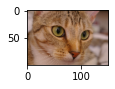

In [ ]:
import cv2
lr_image = cv2.resize(hr_image, dsize=(150,100)) # (가로 픽셀 수, 세로 픽셀 수)

print(lr_image.shape)

plt.figure(figsize=(3,1))
plt.imshow(lr_image)

작아진 고양이 이미지로 Interpolation 방법을 적용해 Super Resolution을 시도해보겠습니다. resize()내의 interpolation 설정에 따라 적용 방법을 조절할 수 있습니다. 아래 코드는 이전에 간략하게 알아보았던 bilinear 및 bicubic interpolation을 적용해 이미지를 '400 x 600 x 3' 크기로 크게 변환하는 예제입니다.

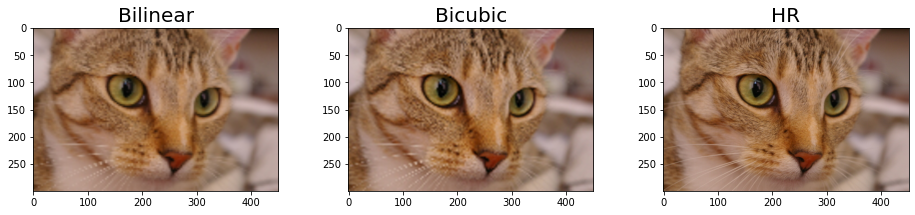

In [ ]:
bilinear_image = cv2.resize(
    lr_image, 
    dsize=(451, 300), # (가로 픽셀 수, 세로 픽셀 수) 
    interpolation=cv2.INTER_LINEAR # bilinear interpolation 적용
)

bicubic_image = cv2.resize(
    lr_image, 
    dsize=(451, 300), # (가로 픽셀 수, 세로 픽셀 수)
    interpolation=cv2.INTER_CUBIC # bicubic interpolation 적용
)

images = [bilinear_image, bicubic_image, hr_image]
titles = ["Bilinear", "Bicubic", "HR"]

plt.figure(figsize=(16,3))
for i, (image, title) in enumerate(zip(images, titles)):
    plt.subplot(1,3,i+1)
    plt.imshow(image)
    plt.title(title, fontsize=20)

Bilinear 및 bicubic interpolation을 적용한 이미지와 원래 고해상도 이미지(위 그림의 HR)를 시각화했습니다. 이미지가 작아 시각적으로 해상도에 큰 차이가 없어 보입니다. 아래 코드를 이용해 특정 부분을 잘라내어 시각화해 봅시다.



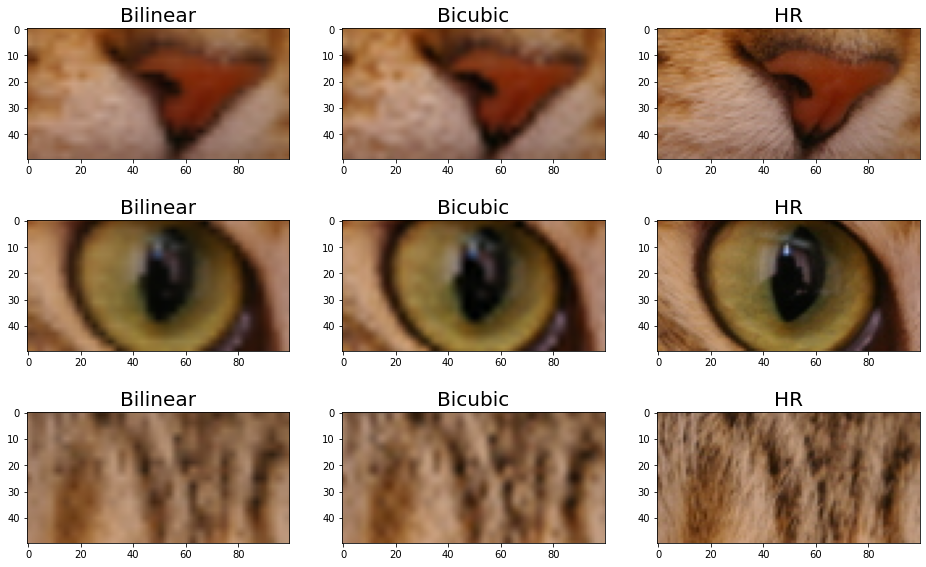

In [ ]:
# 특정 영역을 잘라낼 함수를 정의합니다.
def crop(image, left_top, x=50, y=100):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]


# 잘라낼 영역의 좌표를 정의합니다.
left_tops = [(220,200)] *3 + [(90,120)] *3 + [(30,200)] *3

plt.figure(figsize=(16,10))
for i, (image, left_top, title) in enumerate(zip(images*3, left_tops, titles*3)):
    plt.subplot(3,3,i+1)
    plt.imshow(crop(image, left_top))
    plt.title(title, fontsize=20)

nterpolation 방법을 이용한 Super Resolution 결과는 어떤가요? 이미지만 크게 만들어줄 뿐 세밀한 정보는 거의 찾아볼 수 없는 것을 확인할 수 있습니다.

위와 같은 interpolation 방법은 많은 딥러닝 기반 Super Resolution 연구에서 결과를 비교하기 위해 수행됩니다. 이제부터는 딥러닝 기반 Super Resolution에 대해 간략히 알아보고 실험해 보겠습니다. 그리고 방금 수행한 interpolation 방법과 비교하여 딥러닝을 사용하는 것이 얼마나 성능이 좋은지 한번 직접 느껴봅시다!😆

16-6. Deep Learning을 이용한 Super Resolution (1) SRCNN
SRCNN은 2014년 발표된 "Image Super-Resolution Using Deep Convolutional Networks" 논문에서 사용되었습니다. Super Resolution Convolutional Neural Networks의 앞글자를 따서 SRCNN이라고 불리며, 매우 간단한 모델 구조를 사용했음에도 기존 결과에 비해 큰 성능 향상을 이뤄냈습니다. 지금 이 연구를 보면 너무 간단해 보이지만, Super Resolution 문제에 가장 처음 딥러닝을 적용한 연구로써 이후 많은 딥러닝 기반의 Super Resolution 연구에 큰 영향을 준 정말 멋진 작품(?)입니다🙂

아래 그림이 SRCNN 구조입니다. 간략하게 살펴봅시다.

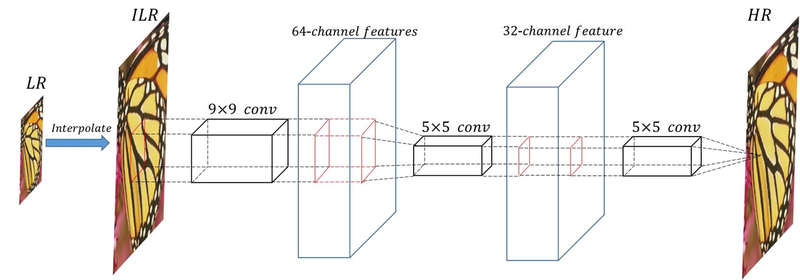
[출처: https://deepai.org/publication/deep-learning-for-single-image-super-resolution-a-brief-review]
가장 먼저 저해상도 이미지(그림의 LR)를 bicubic interpolation 하여 원하는 크기로 이미지를 늘립니다. SRCNN은 이 이미지(그림의 ILR)를 입력으로 사용합니다. 이후 3개의 convolutional layer를 거쳐 고해상도 이미지를 생성해 냅니다. 생성된 고해상도 이미지와 실제 고해상도 이미지 사이의 차이를 역전파 하여 신경망의 가중치를 학습합니다. 최근 발표되는 수 백 개 이상의 convolutional layer를 갖는 CNN과 비교하면 SRCNN은 매우 간단합니다.

SRCNN이 발표된 지 꽤 오랜 시간이 흘렀고, 딥러닝 기반 Super Resolution 분야에서 대표적인 연구로 꼽히는 만큼 이 연구에 대해 정리된 자료들이 매우 많습니다. 아래 SRCNN에 대해 설명한 참고 자료를 읽고 질문에 답해봅시다. (Experiments 이전까지만 보시면 됩니다)



참고 자료: 논문리뷰 - SRCNN
Q6. SRCNN은 3가지 연산으로 구성됩니다. 이에 대해 간략하게 설명해 주세요.

예시답안
1) Patch extraction and representation : 저해상도 이미지에서 patch를 추출한다.
2) Non-linear mapping : Patch를 다른 차원의 patch로 비선형 매핑한다.
3) Reconstruction : Patch로부터 고해상도 이미지를 생성한다.

16-7. Deep Learning을 이용한 Super Resolution (2) SRCNN 이후 제안된 구조들
SRCNN 이후 정말 많은 Super Resolution 연구들이 있으며, 어떠한 방식으로 발전해왔는지 몇 개의 연구들만 간략하게 알아보겠습니다. 아래 방법들은 일반적인 CNN의 발전 과정과 크게 다르지 않으며, Super Resolution뿐만 아니라 많은 컴퓨터 비전 분야에서 사용되는 방법들과 유사합니다. 이 부분은 학습자에 따라 조금 어려운 개념이 있을 수 있으므로, 자세히 이해하기보단 가볍게 읽고 넘어갑시다. (이번 단계는 위의 SRCNN만 알고 가셔도 됩니다!)

VDSR (Very Deep Super Resolution)
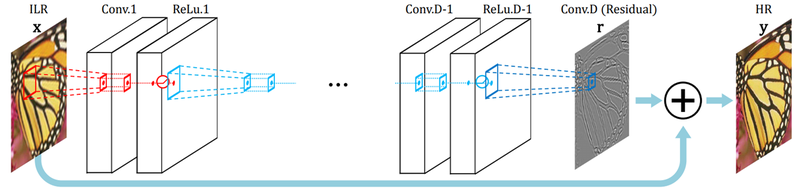

[출처: https://cv.snu.ac.kr/research/VDSR/VDSR_CVPR2016.pdf]
SRCNN과 동일하게 interpolation을 통해 저해상도 이미지의 크기를 늘려 입력으로 사용합니다. 이전보다 훨씬 많은 20개의 convolutional layer를 사용했고, 최종 고해상도 이미지 생성 직전에 처음 입력 이미지를 더하는 residual learning을 이용했습니다. 이러한 깊은 구조를 이용해 SRCNN에 비해 큰 성능 향상을 이끌어 냈습니다.


RDN (Residual Dense Network)
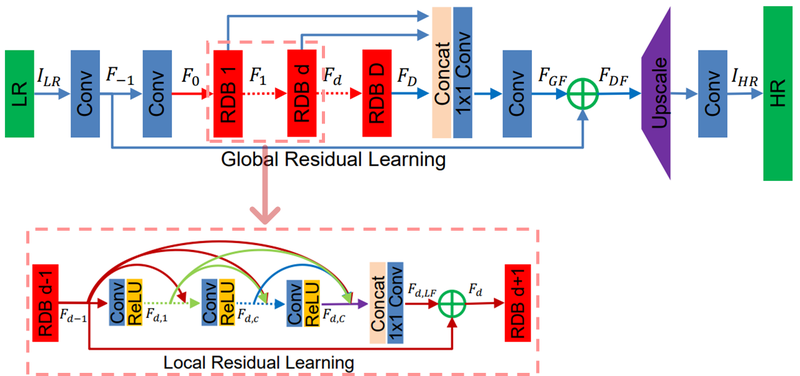

[출처: https://arxiv.org/pdf/1802.08797.pdf]
이전 구조보다 그림이 조금 복잡해졌습니다. RDN은 저해상도 이미지가 입력되면, 여러 단계의 convolutional layer를 거치는데 각 layer에서 나오는 출력을 최대한 활용하도록 합니다. 그림과 같이 각각의 convolution layer 출력 결과로 생성된 특징들이 화살표를 따라 이후 연산에서 여러 번 재활용 하는 것을 볼 수 있습니다. (한 곳으로부터 나온 화살표가 여러 곳을 향하고 있습니다)

RCAN (Residual Channel Attention Networks)


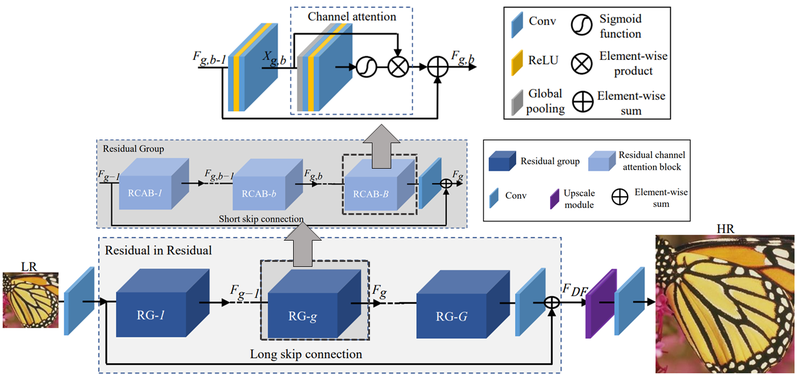
[출처: https://arxiv.org/pdf/1807.02758.pdf]
그림이 더 복잡해졌습니다…..😅 RCAN 구조 또한 많은 convolutional layer를 거치며 학습합니다. 위 구조들과 다른 특별한 점은 convolutional layer의 결과인 각각의 특징 맵을 대상으로 채널 간의 모든 정보가 균일한 중요도를 갖는 것이 아니라 일부 중요한 채널에만 선택적으로 집중하도록 유도했습니다 (맨 위의 Channel attention이라 쓰인 부분). CNN Attention 등의 키워드로 검색하면 RCAN 구조와 비슷한 많은 attention 기술에 대한 정보들을 찾아볼 수 있습니다.

16-8. SRCNN을 이용해 Super Resolution 도전하기
이번에는 앞서 간략하게 알아보았던 SRCNN을 구현하고 실험해봅시다. 맨 처음 시작했을 때 다운로드 한 데이터셋이 준비되어 있어야 합니다.

tensorflow-datasets 라이브러리에서 우리가 사용해 볼 데이터셋은 DIV2K 입니다. DIV2K 데이터셋은 많은 Super Resolution 연구에서 학습 및 평가에 사용되는 데이터셋이며 800개의 학습용 데이터셋 및 100개의 검증용 데이터셋으로 구성되어 있습니다.

앞서 다운로드 한 데이터셋은 div2k/bicubic_x4 이며, 이는 DIV2K 데이터셋 중에서 실제 고해상도 이미지를 대상으로 bicubic interpolation을 이용해 가로 및 세로 픽셀 수를 1/4배로 줄인 데이터셋 입니다. 이렇게 만들어진 저해상도 이미지와 원래 고해상도 이미지가 서로 한 쌍으로 구성되어 있습니다.

데이터셋에 대한 자세한 정보는 아래에서 확인하실 수 있습니다.

참고 자료: DIV2K datasets
❗아래에서 진행하는 SRCNN의 구현 및 학습 과정은 매우 간단한 과정만을 거치며, 실제 SRCNN 논문에서 진행한 방식과 세부적으로 차이가 있습니다. 이에 대한 자세한 내용은 SRCNN의 논문을 참고 바랍니다.

데이터 준비하기
아래 코드를 이용해 DIV2K 데이터셋을 불러옵니다. 아래 코드에서 생성한 train과 valid는 각각 저해상도 및 고해상도 이미지를 쌍으로 담고 있습니다. 그중 한 쌍의 이미지에 대해 시각화해봅시다. 저해상도 이미지를 bicubic interpolation하여 고해상도 이미지와 동일한 크기로 만들었습니다.



EXTRACTING {'train_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_LR_bicubic_X4.zip', 'valid_lr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_LR_bicubic_X4.zip', 'train_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_train_HR.zip', 'valid_hr_url': 'https://data.vision.ee.ethz.ch/cvl/DIV2K/DIV2K_valid_HR.zip'}


Shuffling and writing examples to /root/tensorflow_datasets/div2k/bicubic_x4/2.0.0.incompleteA1DCUJ/div2k-train.tfrecord


Shuffling and writing examples to /root/tensorflow_datasets/div2k/bicubic_x4/2.0.0.incompleteA1DCUJ/div2k-validation.tfrecord


Dataset div2k downloaded and prepared to /root/tensorflow_datasets/div2k/bicubic_x4/2.0.0. Subsequent calls will reuse this data.


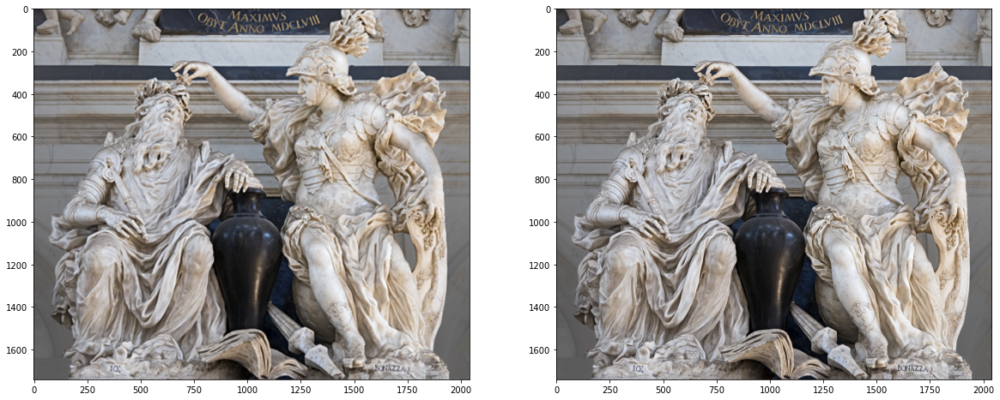

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

# 데이터를 불러옵니다.
train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

# 시각화를 위해 한 개의 데이터만 선택합니다.
for i, (lr, hr) in enumerate(valid):
    if i == 6: break
    
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation 합니다.  
hr, lr = np.array(hr), np.array(lr)
bicubic_hr = cv2.resize(
    lr, 
    dsize=(hr.shape[1], hr.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

# 저해상도 및 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,10))
plt.subplot(1,2,1); plt.imshow(bicubic_hr)
plt.subplot(1,2,2); plt.imshow(hr)

이미지 크기가 꽤 크기 때문에 어렴풋이 봐서는 선명함의 차이가 크지 않은 것 같습니다. 아래 코드를 이용해 각 이미지의 특정 부분을 확대해봅시다.

Text(0.5, 1.0, 'HR')

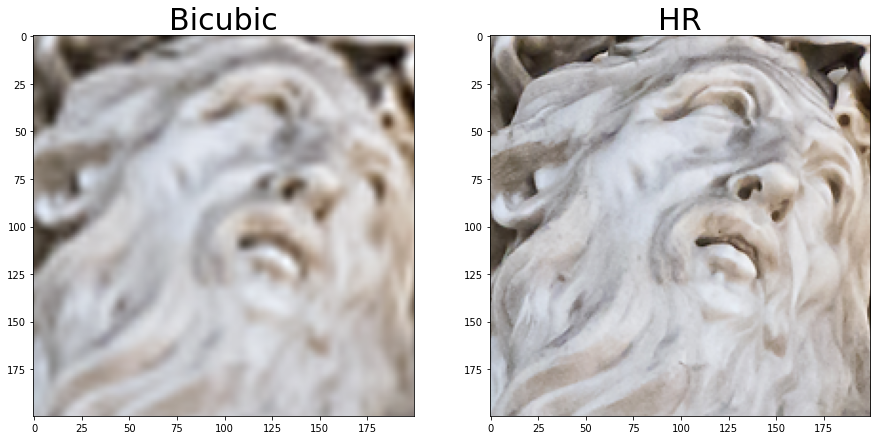

In [ ]:
# 이미지의 특정 부분을 잘라내는 함수를 정의합니다.
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

# interpolation된 이미지와 고해상도 이미지의 동일한 부분을 각각 잘라냅니다.
left_top = (400, 500)
crop_bicubic_hr = crop(bicubic_hr, left_top)
crop_hr = crop(hr, left_top)

# 잘라낸 부분을 시각화 합니다.
plt.figure(figsize=(15,25))
plt.subplot(1,2,1); plt.imshow(crop_bicubic_hr); plt.title("Bicubic", fontsize=30)
plt.subplot(1,2,2); plt.imshow(crop_hr); plt.title("HR", fontsize=30)

Bicubic interpolation 방법을 이용한 결과는 HR이라 쓰여진 실제 고해상도 이미지와 비교하면 매우 선명하지 않은 것을 확인 할 수 있습니다. SRCNN을 이용해 학습한 결과는 얼마나 좋을지 아래에서 확인해 봅시다😆


앞서 언급되었듯이 SRCNN의 입력은 저해상도 이미지를 그대로 사용하는 것이 아닌, 만들고자 하는 고해상도 이미지 크기에 맞게 interpolation이 적용된 이미지입니다. 이 과정을 아래 코드와 같이 수행합니다. 사용할 DIV2K 데이터셋 내의 개별 이미지 크기가 크므로, 일부 영역을 임의로 잘라내어 학습에 활용해 보겠습니다.

In [ ]:
import tensorflow as tf

def preprocessing(lr, hr):
    # 이미지의 크기가 크므로 (96,96,3) 크기로 임의 영역을 잘라내어 사용합니다.
    hr = tf.image.random_crop(hr, size=[96, 96, 3])
    hr = tf.cast(hr, tf.float32) / 255.
    
    # 잘라낸 고해상도 이미지의 가로, 세로 픽셀 수를 1/4배로 줄였다가
    # interpolation을 이용해 다시 원래 크기로 되돌립니다.
    # 이렇게 만든 저해상도 이미지를 입력으로 사용합니다.
    lr = tf.image.resize(hr, [96//4, 96//4], "bicubic")
    lr = tf.image.resize(lr, [96, 96], "bicubic")
    return lr, hr

train = train.map(preprocessing).shuffle(buffer_size=10).batch(16)
valid = valid.map(preprocessing).batch(16)


SRCNN 구현하기
앞서 살펴본 대로 SRCNN은 3개 convolutional layer를 사용한 구조를 가지고 있습니다. 따라서 아래 코드와 같이 Sequential API를 활용해 간단하게 구현할 수 있습니다.

In [ ]:
from tensorflow.keras import layers, Sequential

# 3개의 convolutional layer를 갖는 Sequential 모델을 구성합니다.
srcnn = Sequential()
# 9x9 크기의 필터를 128개 사용합니다.
srcnn.add(layers.Conv2D(128, 9, padding="same", input_shape=(None, None, 3)))
srcnn.add(layers.ReLU())
# 5x5 크기의 필터를 64개 사용합니다.
srcnn.add(layers.Conv2D(64, 5, padding="same"))
srcnn.add(layers.ReLU())
# 5x5 크기의 필터를 64개 사용합니다.
srcnn.add(layers.Conv2D(3, 5, padding="same"))

srcnn.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, None, None, 128)   31232     
_________________________________________________________________
re_lu (ReLU)                 (None, None, None, 128)   0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, None, None, 64)    204864    
_________________________________________________________________
re_lu_1 (ReLU)               (None, None, None, 64)    0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, None, None, 3)     4803      
Total params: 240,899
Trainable params: 240,899
Non-trainable params: 0
_________________________________________________________________


SRCNN 학습하기
최적화 방법과 손실 함수를 설정하고, 앞서 전처리한 데이터를 이용해 아래와 같이 간단하게 학습할 수 있습니다. 우선 1 epoch만 학습 시켜 봅시다.

In [ ]:
srcnn.compile(
    optimizer="adam", 
    loss="mse"
)

srcnn.fit(train, validation_data=valid, epochs=1)

50/50 [==============================] - 130s 1s/step - loss: 0.0977 - val_loss: 0.0127


SRCNN 테스트하기
SRCNN의 학습에는 꽤나 오랜시간이 소요되어 여기서 SRCNN을 처음부터 끝까지 학습시키지 않겠습니다. 대신 SRCNN을 사용해보기 위해 이미 학습이 완료된 SRCNN 모델을 준비했습니다😅 아래 srcnn.h5 파일을 다운로드받은 후 코드를 실행하여 학습 완료된 모델을 불러올 수 있습니다.

In [ ]:
import tensorflow as tf
import os

# model_file = os.getenv('HOME')+'/aiffel/SR/srcnn.h5'
model_file = '/content/drive/MyDrive/DL_Study/AIFFEL/SuperResolution/srcnn.h5'
srcnn = tf.keras.models.load_model(model_file)

아래 코드와 같이 저해상도 이미지를 입력받아 SRCNN을 사용하는 함수를 간단하게 정의하고, 이 함수를 이용해 SRCNN의 결과인 고해상도 이미지를 얻어봅시다.

In [ ]:
def apply_srcnn(image):
    sr = srcnn.predict(image[np.newaxis, ...]/255.)
    sr[sr > 1] = 1
    sr[sr < 0] = 0
    sr *= 255.
    return np.array(sr[0].astype(np.uint8))

srcnn_hr = apply_srcnn(bicubic_hr)

이전 bicubic interpolation을 적용하고 이미지 전체를 시각화했을 때 세부적인 선명함이 눈에 띄지 않았기 때문에, 일부 영역을 잘라내어 시각적으로 비교해보겠습니다. 아래 코드를 이용해 3개 이미지(bicubic interpolation의 결과, SRCNN의 결과, 원래 고해상도 이미지)를 나란히 시각화합니다.

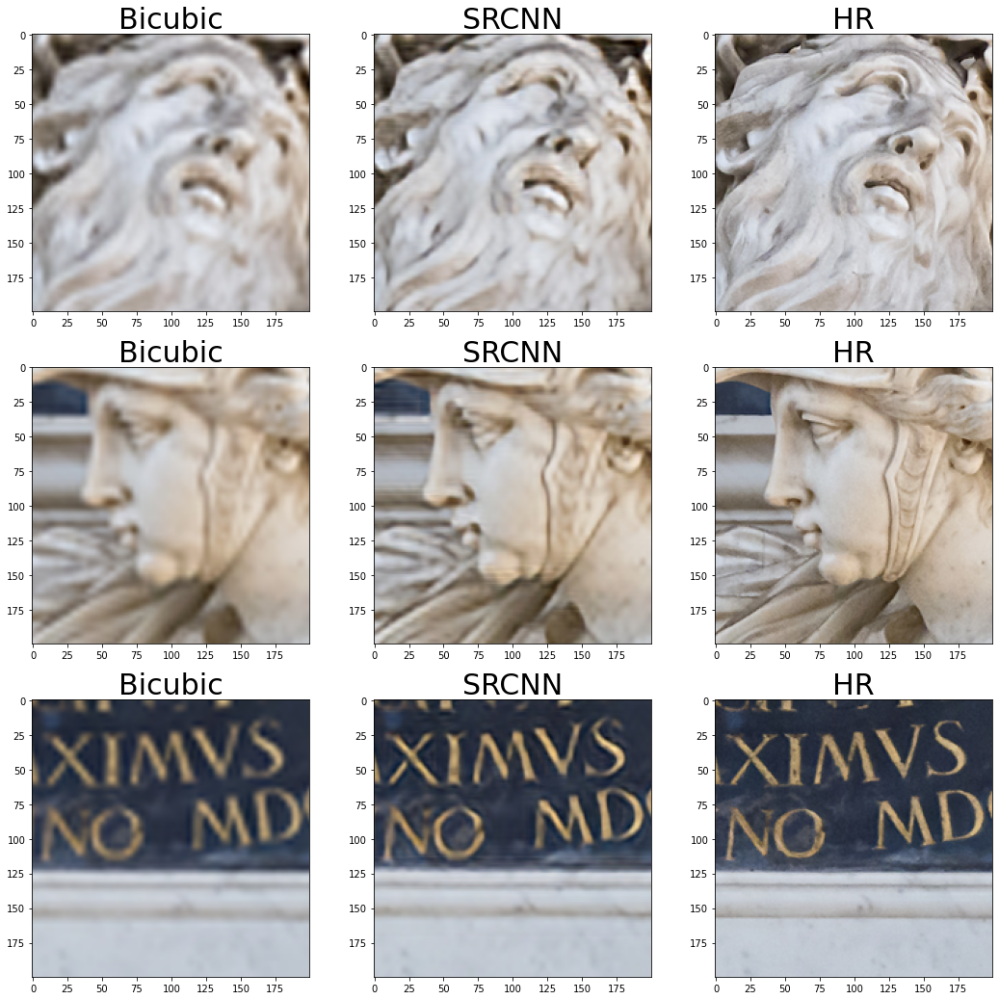

In [ ]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srcnn_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRCNN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

다음 단계에서는 조금 더 강력한 모델에 대해서 알아보고 실험해보겠습니다!

16-9. Deep Learning을 이용한 Super Resolution (3) SRGAN
이번에는 GAN(Generative Adversarial Networks) 을 활용한 Super Resolution 과정에 대해 다뤄보려 합니다. 고해상도 이미지를 만들어 내는 데 GAN이 어떻게 활용될 수 있고, 이를 활용했을 때 어떠한 장점이 있는지 학습을 통해 알아봅시다.

다시 한번, GAN
이번 학습을 시작하기 전에 GAN을 대략적으로 알고 있다고 전제 했지만, GAN에 대해 다시 한번 가볍게 정리해 보겠습니다. 아래 참고 자료를 읽고 질문에 답해봅시다.

참고 자료: GAN - 스스로 학습하는 인공지능
Q8. 위 자료에서는 데이터의 확률분포를 모델링 할 수 있다면, 무엇이 가능하다고 했나요?
예시답안
원래 데이터와 확률분포를 정확히 공유하는 무한히 많은 새로운 데이터를 생성할 수 있다.
Q9. GAN의 학습이 완료되었을 때, Generator(생성자)와 Discriminator(판별자)의 출력은 무엇인가요?
예시답안
Generator의 경우 원 데이터의 확률분포를 따르는 새로운 데이터를 만들며, Discriminator의 경우 분류에 의미가 없는 0.5의 확률값을 출력한다


SRGAN = Super Resoultion + GAN
최근 Super Resolution 분야에서 GAN은 매우 많이 활용되고 있습니다. 이번에는 가장 처음으로 Super Resolution에 GAN을 이용한 연구인 SRGAN에 대해 알아보겠습니다. SRGAN은 2016년 발표된 "Photo-Realistic Single Image Super-Resolution Using a Generative Adversarial Network" 논문에서 제안되었으며, 아래 그림과 같이 이전에 학습한 SRCNN 보다 조금 복잡한 구조를 갖습니다. 논문 제목부터 "Photo-Realistic"이라 쓰여있으니 얼마나 좋은 결과가 나올지 기대가 됩니다🤔

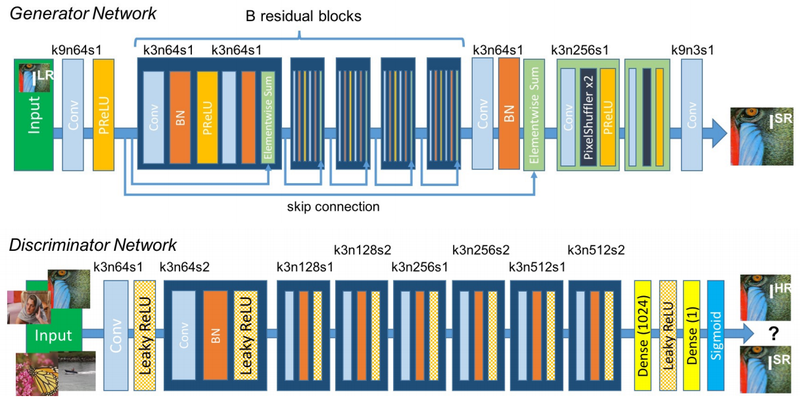

[출처: https://arxiv.org/pdf/1609.04802.pdf]
그림의 Generator Network와 Discriminator Network는 각각 위에서 비유했던 위조지폐범(생성 모델)과 경찰(분류/판별 모델)입니다. Generator가 저해상도 이미지를 입력 받아 (가짜)고해상도 이미지를 생성해 내면, Discriminator는 생성된 (가짜)고해상도 이미지와 실제(진짜) 고해상도 이미지 중 진짜를 판별합니다.

Generator는 Discriminator를 속이려하고 Discriminator는 진짜를 가려내려는 학습이 진행될 수록 서로 경쟁자가 되어 둘 모두가 점점 발전합니다. 학습이 거의 완료 되면 최종적으로 Generator가 생성해낸 (가짜)고해상도 이미지는 Discriminator가 진짜인지 가짜인지를 구분하기 힘들 정도로 매우 좋은 품질을 가진 고해상도 이미지가 됩니다😁


SRGAN에서 사용하는 loss function은 아래와 같이 조금 특별합니다(?).

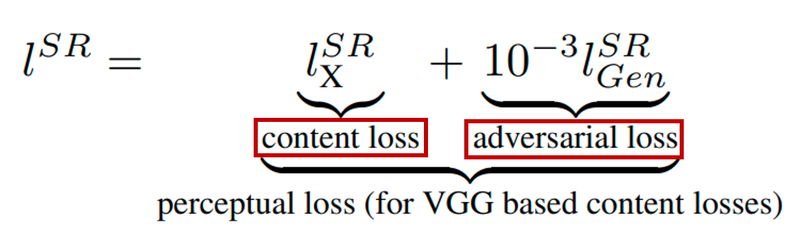

[출처: https://arxiv.org/pdf/1609.04802.pdf]
위 식을 보면 크게 content loss와 adversarial loss로 구성되어 있고, 이 중 adversarial loss는 우리가 일반적으로 알고 있는 GAN의 loss이며, 조금 특별한 부분은 아래 그림으로 나타낸 content loss 부분 입니다.


content loss는 Generator를 이용해 얻어낸 (가짜) 고해상도 이미지를 실제 (진짜) 고해상도 이미지와 직접 비교하는 것이 아니라, 각 이미지를 이미지넷으로 사전 학습된(pre-trained) VGG 모델에 입력하여 나오는 feature map에서의 차이를 계산합니다.
즉, 이전에 학습했던 SRCNN은 생성해낸 고해상도 이미지를 원래 고해상도 이미지와 직접 비교하여 loss를 계산했지만, SRGAN에서는 생성된 고해상도 이미지와 실제 고해상도 이미지를 VGG에 입력하여 모델 중간에서 추출해낸 특징을 비교해서 loss를 계산합니다.
SRGAN은 VGG를 이용한 content loss 및 GAN을 사용함으로써 발생하는 adversarial loss를 합하여 최종적으로 perceptual loss라고 정의하며 이를 학습에 이용합니다.
이렇게 복잡한 손실 함수를 정의한 이유가 무엇일까요? 우선 다음 단계에서 SRGAN을 실험해 보고 이러한 손실 함수를 사용한 장점에 대해 다뤄보겠습니다.

16-10. SRGAN을 이용해 Super Resolution 도전하기

SRCNN에 이어서 간략하게 알아본 SRGAN을 구현하고 실험해봅시다. 마찬가지로 이전 SRCNN에 사용했던 DIV2K 데이터셋을 사용합니다.

❗SRCNN과 마찬가지로 아래에서 진행하는 SRGAN의 학습 과정은 간단한 과정만을 거치며 실제 SRGAN 논문에서 진행한 실험 과정과 세부적으로 차이가 있습니다. 이에 대한 자세한 내용은 SRGAN의 논문을 참고 바랍니다.



데이터 준비하기
SRCNN은 저해상도 이미지에 대해 interpolation하여 고해상도 이미지 크기로 맞춘 후 입력으로 사용했지만, SRGAN은 그러한 과정을 거치지 않습니다.

In [ ]:
train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)
def preprocessing(lr, hr):
    hr = tf.cast(hr, tf.float32) /255.
        
    # 이미지의 크기가 크므로 (96,96,3) 크기로 임의 영역을 잘라내어 사용합니다.
    hr_patch = tf.image.random_crop(hr, size=[96,96,3])
        
    # 잘라낸 고해상도 이미지의 가로, 세로 픽셀 수를 1/4배로 줄입니다
    # 이렇게 만든 저해상도 이미지를 SRGAN의 입력으로 사용합니다.
    lr_patch = tf.image.resize(hr_patch, [96//4, 96//4], "bicubic")
    return lr_patch, hr_patch

train = train.map(preprocessing).shuffle(buffer_size=10).repeat().batch(8)
valid = valid.map(preprocessing).repeat().batch(8)
print("✅")

✅


SRGAN 구현하기
먼저, 저해상도 이미지를 입력받아 고해상도 이미지를 생성하는 Generator를 구현해 봅시다! SRGAN의 Generator 부분은 아래와 같습니다.

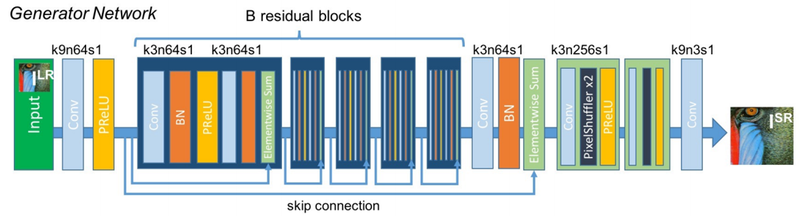
[출처: https://arxiv.org/pdf/1609.04802.pdf]
그림 내의 k9n64s1라는 표기는 Convolutional layer 내의 hyperparameter 설정에 대한 정보이며, k는 kernel size, n은 사용 필터의 수, s는 stride를 나타냅니다. Tensorflow로 구현한다면 Conv2D(filters=64, kernel_size=9, strides=1, padding="same") 처럼 작성할 수 있습니다. 추가로 모든 stride가 1인 convolutional layer에는 패딩을 통해 출력의 크기를 계속 유지합니다.

SRGAN의 Generator에는 skip-connection을 가지고 있으며, 이는 Sequential API로 구현할 수 없으므로 Functional API를 이용해 아래와 같이 구현해 보겠습니다. 위 Generator 그림에서 각 layer를 따라 비교하면서 아래 코드를 이해해 봅시다.

In [ ]:
from tensorflow.keras import Input, Model

# 그림의 파란색 블록을 정의합니다.
def gene_base_block(x):
    out = layers.Conv2D(64, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.PReLU(shared_axes=[1,2])(out)
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.Add()([x, out])

# 그림의 뒤쪽 연두색 블록을 정의합니다.
def upsample_block(x):
    out = layers.Conv2D(256, 3, 1, "same")(x)
    # 그림의 PixelShuffler 라고 쓰여진 부분을 아래와 같이 구현합니다.
    out = layers.Lambda(lambda x: tf.nn.depth_to_space(x, 2))(out)
    return layers.PReLU(shared_axes=[1,2])(out)
    
# 전체 Generator를 정의합니다.
def get_generator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 9, 1, "same")(inputs)
    out = residual = layers.PReLU(shared_axes=[1,2])(out)
    
    for _ in range(5):
        out = gene_base_block(out)
    
    out = layers.Conv2D(64, 3, 1, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.Add()([residual, out])
    
    for _ in range(2):
        out = upsample_block(out)
        
    out = layers.Conv2D(3, 9, 1, "same", activation="tanh")(out)
    return Model(inputs, out)

print("✅")

✅


이번에는 생성된 고해상도 이미지와 진짜 고해상도 이미지 사이에서 진짜를 판별해내는 Discriminator를 아래 그림에 따라 구현해 보겠습니다. 마찬가지로 Functional API를 사용합니다.

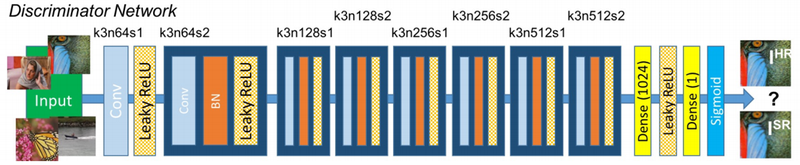
[출처: https://arxiv.org/pdf/1609.04802.pdf]

In [ ]:
# 그림의 파란색 블록을 정의합니다.
def disc_base_block(x, n_filters=128):
    out = layers.Conv2D(n_filters, 3, 1, "same")(x)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(n_filters, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    return layers.LeakyReLU()(out)

# 전체 Discriminator 정의합니다.
def get_discriminator(input_shape=(None, None, 3)):
    inputs = Input(input_shape)
    
    out = layers.Conv2D(64, 3, 1, "same")(inputs)
    out = layers.LeakyReLU()(out)
    out = layers.Conv2D(64, 3, 2, "same")(out)
    out = layers.BatchNormalization()(out)
    out = layers.LeakyReLU()(out)
    
    for n_filters in [128, 256, 512]:
        out = disc_base_block(out, n_filters)
    
    out = layers.Dense(1024)(out)
    out = layers.LeakyReLU()(out)
    out = layers.Dense(1, activation="sigmoid")(out)
    return Model(inputs, out)

print("✅")

✅


SRGAN은 VGG19를 이용해 content loss를 계산합니다. Tensorflow는 이미지넷 데이터로부터 잘 학습된 VGG19를 제공하고 있으며 이를 이용해 보겠습니다.

In [ ]:
from tensorflow.python.keras import applications
def get_feature_extractor(input_shape=(None, None, 3)):
    vgg = applications.vgg19.VGG19(
        include_top=False, 
        weights="imagenet", 
        input_shape=input_shape
    )
    # 아래 vgg.layers[20]은 vgg 내의 마지막 convolutional layer 입니다.
    return Model(vgg.input, vgg.layers[20].output)

print("✅")

✅


SRGAN 학습하기
이제부터는 앞에서 정의한 신경망들을 이용해 SRGAN을 학습해 보겠습니다. 이전에 SRCNN과 마찬가지로 학습에 꽤나 오랜 시간이 소요되므로 SRGAN의 학습을 처음부터 전부 진행하진 않겠습니다. 여기서는 200번의 반복만 진행해보겠습니다.
(초반 학습이 불안정하여 Generator의 loss가 증가할 수도 있습니다)



In [ ]:
from tensorflow.keras import losses, metrics, optimizers

generator = get_generator()
discriminator = get_discriminator()
vgg = get_feature_extractor()

# 사용할 loss function 및 optimizer 를 정의합니다.
bce = losses.BinaryCrossentropy(from_logits=False)
mse = losses.MeanSquaredError()
gene_opt = optimizers.Adam()
disc_opt = optimizers.Adam()

def get_gene_loss(fake_out):
    return bce(tf.ones_like(fake_out), fake_out)

def get_disc_loss(real_out, fake_out):
    return bce(tf.ones_like(real_out), real_out) + bce(tf.zeros_like(fake_out), fake_out)


@tf.function
def get_content_loss(hr_real, hr_fake):
    hr_real = applications.vgg19.preprocess_input(hr_real)
    hr_fake = applications.vgg19.preprocess_input(hr_fake)
    
    hr_real_feature = vgg(hr_real) / 12.75
    hr_fake_feature = vgg(hr_fake) / 12.75
    return mse(hr_real_feature, hr_fake_feature)


@tf.function
def step(lr, hr_real):
    with tf.GradientTape() as gene_tape, tf.GradientTape() as disc_tape:
        hr_fake = generator(lr, training=True)
        
        real_out = discriminator(hr_real, training=True)
        fake_out = discriminator(hr_fake, training=True)
        
        perceptual_loss = get_content_loss(hr_real, hr_fake) + 1e-3 * get_gene_loss(fake_out)
        discriminator_loss = get_disc_loss(real_out, fake_out)
        
    gene_gradient = gene_tape.gradient(perceptual_loss, generator.trainable_variables)
    disc_gradient = disc_tape.gradient(discriminator_loss, discriminator.trainable_variables)
    
    gene_opt.apply_gradients(zip(gene_gradient, generator.trainable_variables))
    disc_opt.apply_gradients(zip(disc_gradient, discriminator.trainable_variables))
    return perceptual_loss, discriminator_loss


gene_losses = metrics.Mean()
disc_losses = metrics.Mean()

for epoch in range(1, 2):
    for i, (lr, hr) in enumerate(train):
        g_loss, d_loss = step(lr, hr)
        
        gene_losses.update_state(g_loss)
        disc_losses.update_state(d_loss)
        
        # 10회 반복마다 loss를 출력합니다.
        if (i+1) % 10 == 0:
            print(f"EPOCH[{epoch}] - STEP[{i+1}] \nGenerator_loss:{gene_losses.result():.4f} \nDiscriminator_loss:{disc_losses.result():.4f}", end="\n\n")
        
        if (i+1) == 200:
            break
            
    gene_losses.reset_states()
    disc_losses.reset_states()

80142336/80134624 [==============================] - 0s 0us/step
EPOCH[1] - STEP[10] 
Generator_loss:0.0012 
Discriminator_loss:1.8983

EPOCH[1] - STEP[20] 
Generator_loss:0.0011 
Discriminator_loss:1.4810

EPOCH[1] - STEP[30] 
Generator_loss:0.0014 
Discriminator_loss:1.2074

EPOCH[1] - STEP[40] 
Generator_loss:0.0015 
Discriminator_loss:1.0408

EPOCH[1] - STEP[50] 
Generator_loss:0.0019 
Discriminator_loss:0.8754

EPOCH[1] - STEP[60] 
Generator_loss:0.0023 
Discriminator_loss:0.7453

EPOCH[1] - STEP[70] 
Generator_loss:0.0028 
Discriminator_loss:0.6518

EPOCH[1] - STEP[80] 
Generator_loss:0.0032 
Discriminator_loss:0.5729

EPOCH[1] - STEP[90] 
Generator_loss:0.0034 
Discriminator_loss:0.5108

EPOCH[1] - STEP[100] 
Generator_loss:0.0037 
Discriminator_loss:0.4608

EPOCH[1] - STEP[110] 
Generator_loss:0.0039 
Discriminator_loss:0.4203

EPOCH[1] - STEP[120] 
Generator_loss:0.0041 
Discriminator_loss:0.3856

EPOCH[1] - STEP[130] 
Generator_loss:0.0043 
Discriminator_loss:0.3564

EPOCH[1]

In [ ]:
import tensorflow as tf
import os

model_file = '/content/drive/MyDrive/DL_Study/AIFFEL/SuperResolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

train, valid = tfds.load(
    "div2k/bicubic_x4", 
    split=["train","validation"],
    as_supervised=True
)

for i, (lr, hr) in enumerate(valid):
    if i == 6: break

srgan_hr = apply_srgan(lr)
print("✅")

✅


이미지 전체를 시각화했을 때 세부적인 선명함이 눈에 띄지 않았기 때문에, 일부 영역을 잘라내어 시각적으로 비교해보겠습니다. 아래 코드를 이용해 3개 이미지(bicubic interpolation의 결과, SRGAN의 결과, 원래 고해상도 이미지)를 나란히 시각화합니다.

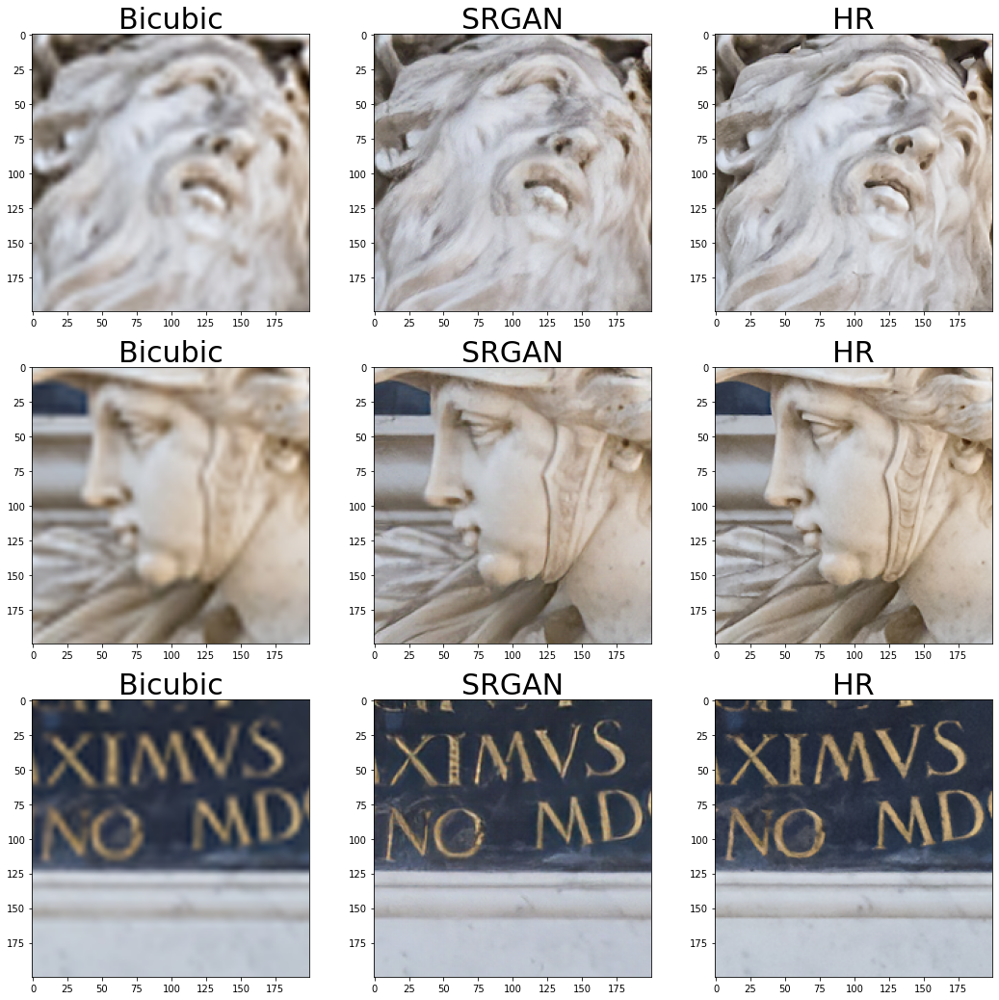

In [ ]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,500), (300,1200), (0,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

시각화 결과 bicubic interpolation보다 훨씬 더 원래 고해상도 이미지에 가까운, 꽤나 만족할만한 결과를 얻은 것 같습니다! 이전에 사용했던 SRCNN 보다 더 깊은 신경망 구조를 사용했고, GAN 및 VGG 구조를 이용한 손실 함수를 사용해 복잡하게 학습 과정을 구성한 보람이 있네요😆

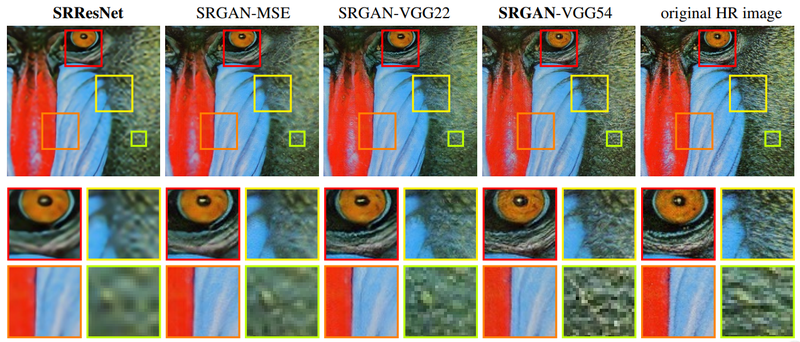
[출처: https://arxiv.org/pdf/1609.04802.pdf]
위 그림은 SRGAN 논문에서 세부적으로 실험한 결과를 나타냅니다. 가장 첫 번째 SRResNet은 SRGAN의 Generator를 뜻하며, Generator 구조만 이용해 SRCNN과 비슷하게 MSE 손실함수로 학습한 결과입니다. 오른쪽으로 갈수록 GAN 및 VGG 구조를 이용하여 점점 더 이미지 내 세부적인 구조가 선명해짐을 알 수 있습니다. (VGG22는 VGG54에 비해 더 low-level의 특징에서 손실을 계산했습니다)

다음 단계에서는 Super Resolution 결과를 평가하는 방법에 대해서 알아보고 SRCNN과 SRGAN 결과를 직접 비교해봅시다.

16-11. Super Resolution 결과 평가하기
Super Resolution 결과가 얼마나 좋은지 많은 연구들에서 사용되는 정량적인 평가 척도가 몇 가지 있습니다. 이번에는 이러한 척도에 대해 간략하게 알아보고 이를 활용해 앞서 진행한 SRCNN과 SRGAN 모델 각각이 만들어낸 고해상도 이미지를 비교해 봅시다.

PSNR과 SSIM
PSNR(Peak Signal-to-Noise Ratio)은 영상 내 신호가 가질 수 있는 최대 신호에 대한 잡음(noise)의 비율을 나타냅니다. 일반적으로 영상을 압축했을 때 화질이 얼마나 손실되었는지 평가하는 목적으로 사용됩니다. 데시벨(db) 단위를 사용하며, PSNR 수치가 높을수록 원본 영상에 비해 손실이 적다는 의미입니다 (값이 높을수록 좋습니다).

SSIM(Structural Similarity Index Map)은 영상의 구조 정보를 고려하여 얼마나 구조 정보를 변화시키지 않았는지를 계산합니다. 특정 영상에 대한 SSIM값이 높을수록 원본 영상의 품질에 가깝다는 의미입니다 (마찬가지로 값이 높을수록 좋습니다).

이번 학습에서는 위와 같은 정량적 평가 척도에 대해 자세히 다루지는 않습니다. PSNR과 SSIM 결과가 높을수록 비교하려는 영상이 원본 영상 품질에 가깝다는 사실만 알고 넘어가셔도 되며, 이에 대해 자세히 이해하고자 하신다면 아래 참고 자료를 읽어 보시길 바랍니다.

참고 자료: 최대신호대잡음비(PSNR)와 이미지 품질
참고 자료: 2D 이미지 품질 평가에 구조변화를 반영하는 SSIM과 그의 변형들
PSNR과 SSIM은 scikit-image 라이브러리를 이용해 쉽게 계산할 수 있습니다. 아래 코드를 따라서 간단하게 실험해 봅시다. 이전에 보았던 고양이를 다시 데려오겠습니다🐱

(300, 451, 3)


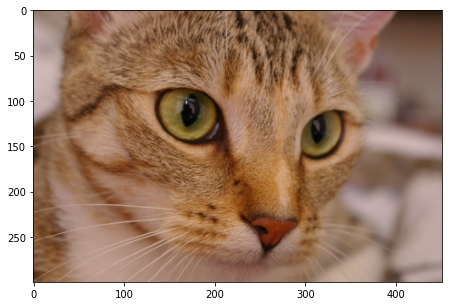

In [ ]:
from skimage import data
import matplotlib.pyplot as plt

hr_cat = data.chelsea() # skimage에서 제공하는 예제 이미지를 불러옵니다.
hr_shape = hr_cat.shape[:2]

print(hr_cat.shape) # 이미지의 크기를 출력합니다.

plt.figure(figsize=(8,5))
plt.imshow(hr_cat)

동일한 이미지로 PSNR과 SSIM을 계산해 보겠습니다. 아래 코드와 같이 peak_signal_noise_ratio , structural_similarity 두 메서드를 이용하면 쉽게 계산할 수 있습니다.

In [ ]:
from skimage.metrics import peak_signal_noise_ratio, structural_similarity

print("**동일 이미지 비교**")
print("PSNR :", peak_signal_noise_ratio(hr_cat, hr_cat))
print("SSIM :", structural_similarity(hr_cat, hr_cat, multichannel=True))

**동일 이미지 비교**
PSNR : inf
SSIM : 1.0


/usr/local/lib/python3.7/dist-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


/usr/local/lib/python3.7/dist-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


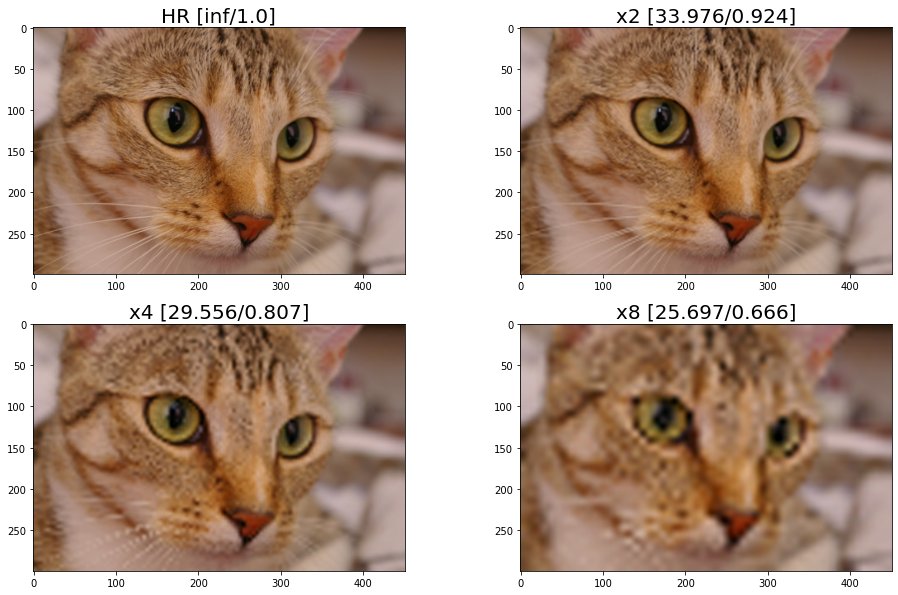

In [ ]:
import cv2

# 이미지를 특정 크기로 줄이고 다시 늘리는 과정을 함수로 정의합니다.
def interpolation_xn(image, n):
    downsample = cv2.resize(
        image,
        dsize=(hr_shape[1]//n, hr_shape[0]//n)
    )
    upsample = cv2.resize(
        downsample,
        dsize=(hr_shape[1], hr_shape[0]),
        interpolation=cv2.INTER_CUBIC
    )
    return upsample

lr2_cat = interpolation_xn(hr_cat, 2) # 1/2로 줄이고 다시 복원
lr4_cat = interpolation_xn(hr_cat, 4) # 1/4로 줄이고 다시 복원
lr8_cat = interpolation_xn(hr_cat, 8) # 1/8로 줄이고 다시 복원

images = [hr_cat, lr2_cat, lr4_cat, lr8_cat]
titles = ["HR", "x2", "x4", "x8"]

# 각 이미지에 대해 PSNR을 계산하고 반올림합니다.
psnr = [round(peak_signal_noise_ratio(hr_cat, i), 3) for i in images]
# 각 이미지에 대해 SSIM을 계산하고 반올림합니다.
ssim = [round(structural_similarity(hr_cat, i, multichannel=True), 3) for i in images]

# 이미지 제목에 PSNR과 SSIM을 포함하여 시각화 합니다. 
plt.figure(figsize=(16,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=20)

각 이미지의 제목에 PSNR과 SSIM이 순서대로 나타났습니다. 해상도를 줄일수록 그 이미지를 원래 크기로 interploation 했을 때, 각각의 계산 결과가 눈에 띄게 감소하는 것을 알 수 있습니다.

16-12. SRCNN 및 SRGAN 결과 비교하기
이번에는 앞서 실험했던 SRCNN과 SRGAN의 결과를 먼저 시각적으로만 비교해 보겠습니다. 이전에 불러온 DIV2K 데이터셋 내에서 학습에 사용하지 않은 검증용 데이터셋을 이용하며, 몇 개 이미지만 뽑아서 Super Resolution을 진행한 후 특정 부분을 잘라내어 확대해봅시다.

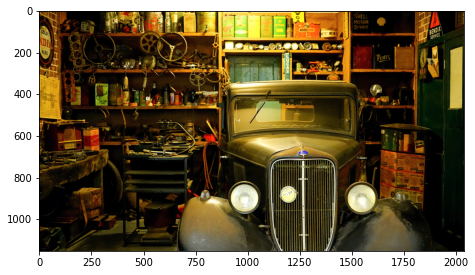

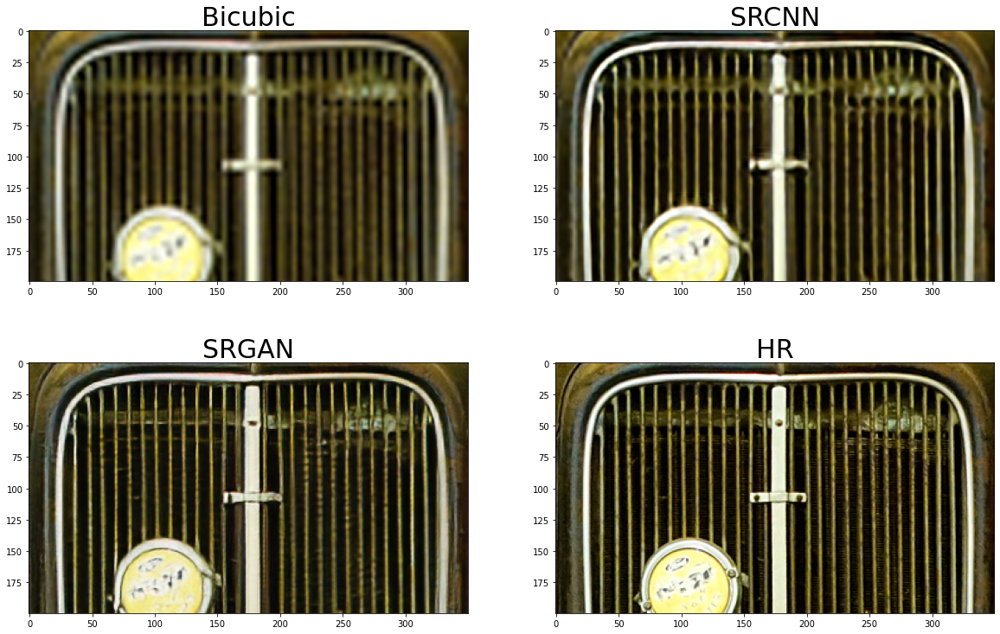

In [ ]:
for i, (lr, hr) in enumerate(valid):
    if i == 12: break # 12번째 이미지를 불러옵니다.

lr_img, hr_img = np.array(lr), np.array(hr)

# bicubic interpolation
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

# 전체 이미지를 시각화합니다.
plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

# SRCNN을 이용해 고해상도로 변환합니다.
srcnn_img = apply_srcnn(bicubic_img)

# SRGAN을 이용해 고해상도로 변환합니다.
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (700, 1090) # 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.

# bicubic, SRCNN, SRGAN 을 적용한 이미지와 원래의 고해상도 이미지를 시각화합니다.
plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

자동차의 앞부분을 잘라내어 확대했습니다. HR이라는 제목을 가진 고해상도 이미지와 비교할 때, Bicubic과 SRCNN은 많이 흐릿하지만 SRGAN의 결과는 매우 비슷하네요😃



아래 코드를 실행하면서 몇 가지 이미지에 대해 동일한 과정으로 비교해봅시다.

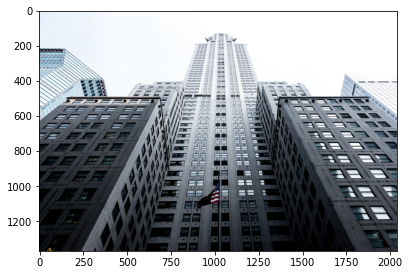

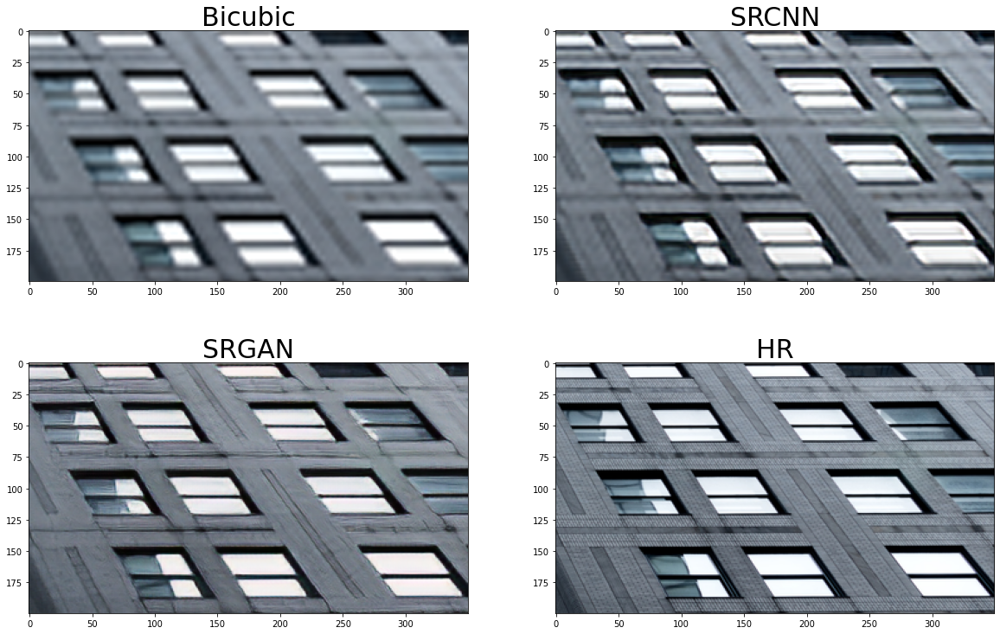

In [ ]:
for i, (lr, hr) in enumerate(valid):
    if i == 15: break

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (600, 1500)

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

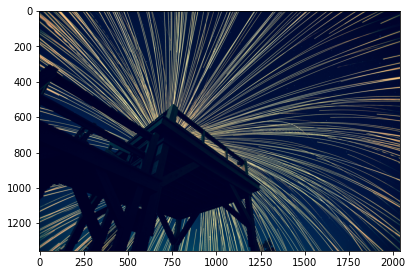

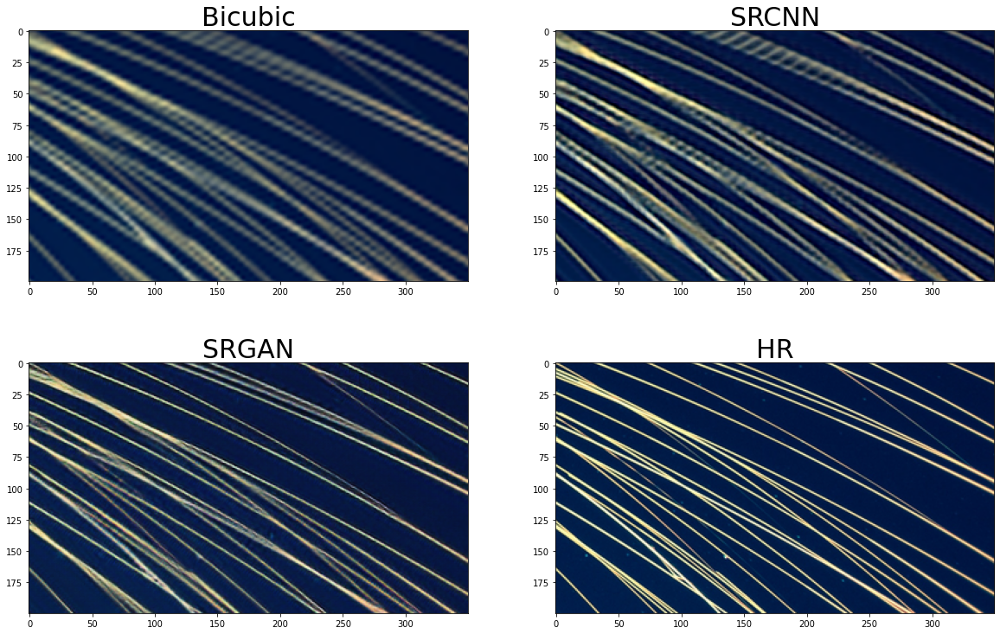

In [ ]:
for i, (lr, hr) in enumerate(valid):
    if i == 8: break

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (900, 1500)

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

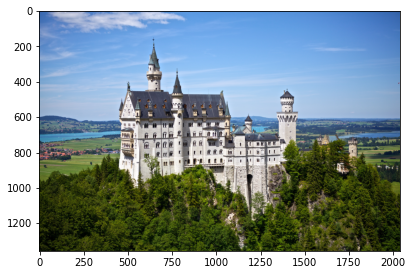

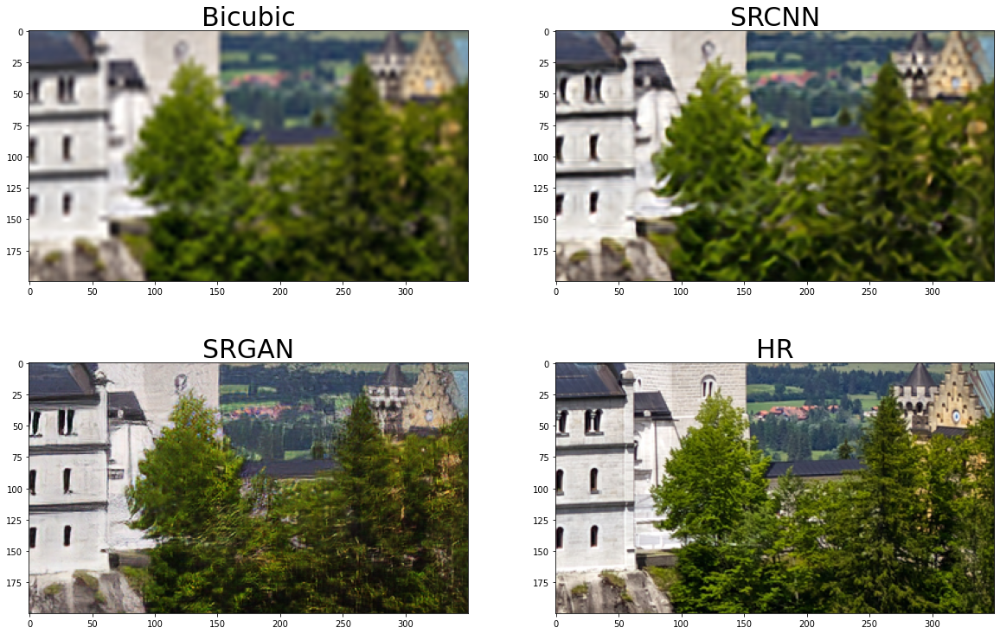

In [ ]:
for i, (lr, hr) in enumerate(valid):
    if i == 24: break

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

left_top = (700, 1300)

plt.figure(figsize=(20,20))
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

아래 코드에서는 여러분이 직접 이미지를 고르고, 잘라내어 확대할 부분을 지정하여 실행해 봅시다. 코드 내 ##TODO## 라고 쓰여진 두 부분을 입력하면 됩니다.


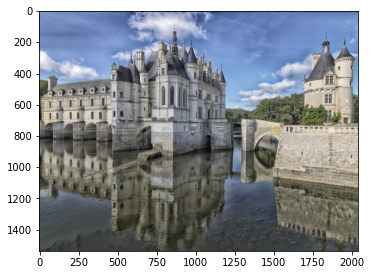

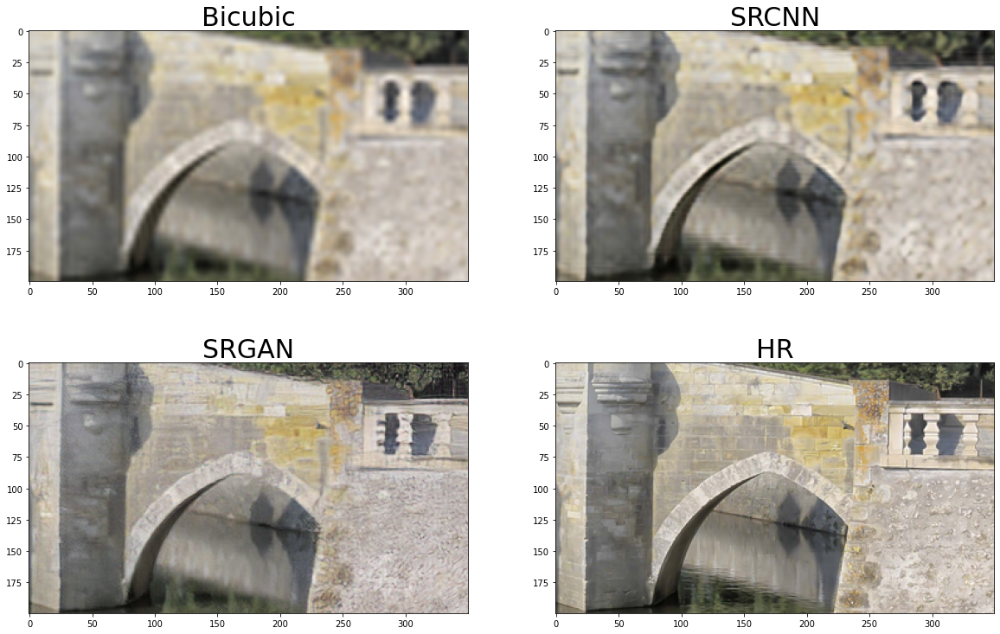

In [ ]:
for i, (lr, hr) in enumerate(valid):
    # 불러올 이미지의 인덱스를 지정합니다.
    # 위에서 시각화 했던 8, 12, 15, 24 번을 제외한 다른 숫자를 넣어봅시다 
    if i == 33: 
        break          

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img, 
    (hr.shape[1], hr.shape[0]), 
    interpolation=cv2.INTER_CUBIC
)

plt.figure(figsize=(20,15))
plt.subplot(311); plt.imshow(hr_img)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

# 잘라낼 부분의 왼쪽 상단 좌표를 지정합니다.
left_top =(700, 1300)

plt.figure(figsize=(20,20)) # 이미지 크기를 조절할 수 있습니다.
for i, pind in enumerate([321, 322, 323, 324]):
    plt.subplot(pind)
    # crop 함수 내의 세번째 네번째 인자를 수정해 이미지 크기를 조절합니다.
    plt.imshow(crop(images[i], left_top, 200, 350))
    plt.title(titles[i], fontsize=30)

이번에는 각 Super Resolution 결과와 원래 고해상도 이미지 사이의 PSNR, SSIM을 계산해 보겠습니다. 이전과 마찬가지로 아래 코드를 이용해 각 이미지의 제목에 평가 결과를 함께 표시하도록 합니다.

/usr/local/lib/python3.7/dist-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


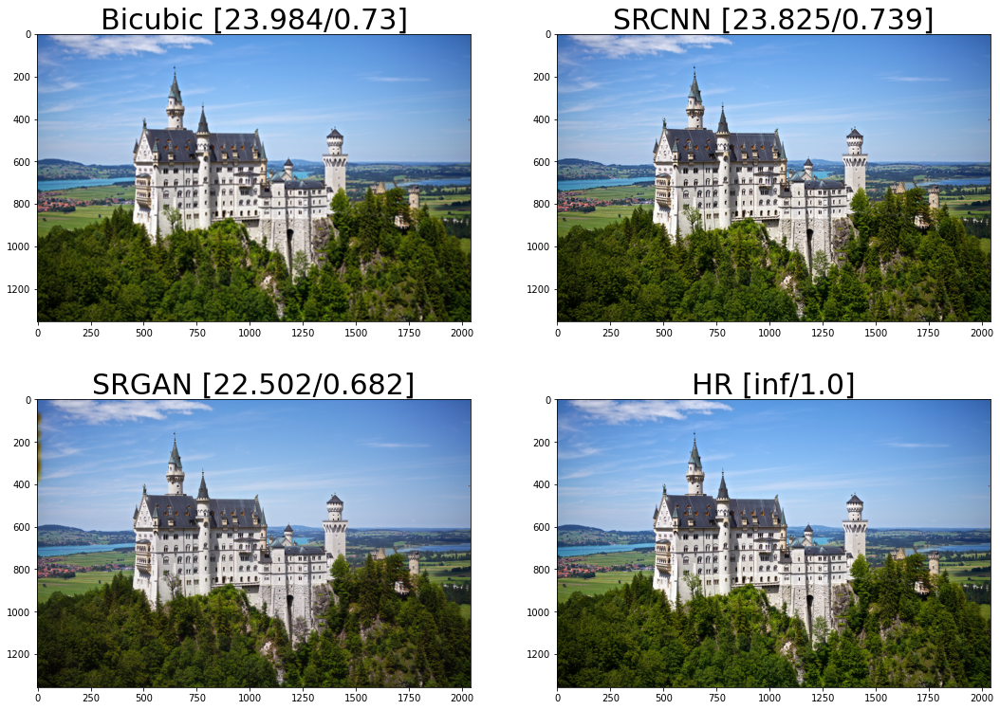

In [ ]:
for i, (lr, hr) in enumerate(valid):
    if i == 24: break
    
lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img,
    (hr.shape[1], hr.shape[0]),
    interpolation=cv2.INTER_CUBIC
)

srcnn_img = apply_srcnn(bicubic_img)
srgan_img = apply_srgan(lr_img)

images = [bicubic_img, srcnn_img, srgan_img, hr_img]
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

# 각 이미지에 대해 PSNR을 계산하고 반올림합니다.
psnr = [round(peak_signal_noise_ratio(hr_img, i), 3) for i in images]
# 각 이미지에 대해 SSIM을 계산하고 반올림합니다.
ssim = [round(structural_similarity(hr_img, i, multichannel=True), 3) for i in images]

# 이미지 제목에 PSNR과 SSIM을 포함하여 시각화 합니다. 
plt.figure(figsize=(18,13))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

어떻게 된 일인지 시각적으로 가장 고해상도 이미지에 가까웠던 SRGAN의 결과가 다른 방법들에 비해 낮은 PSNR과 SSIM 결과를 가집니다. 아래에서 이 이미지에 대해 특정 부분을 잘라내고, 잘라낸 이미지로 PSNR, SSIM을 계산해 봅시다.

건물의 창문 부분을 잘라 자세히 보겠습니다.

/usr/local/lib/python3.7/dist-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


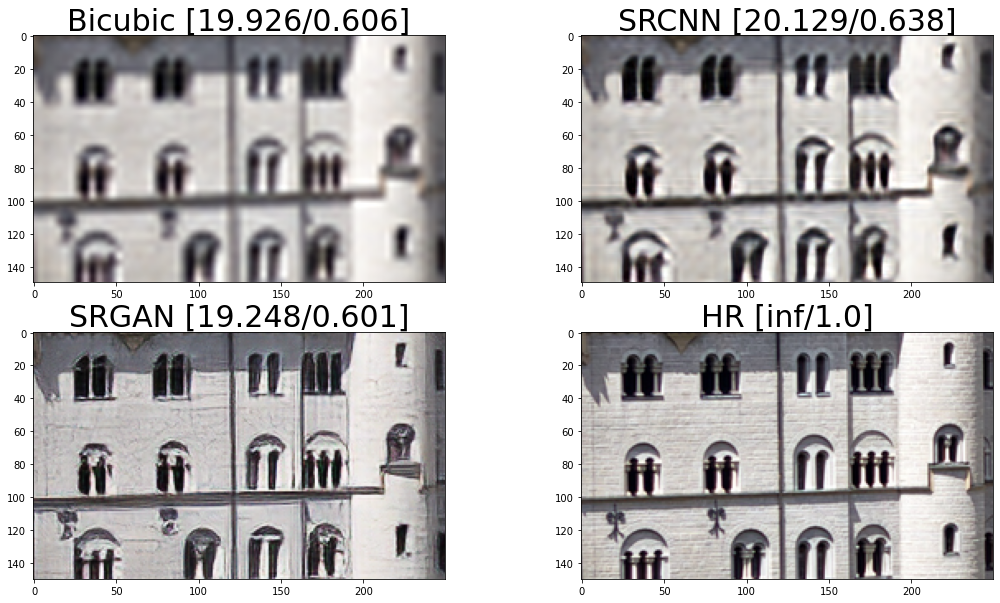

In [ ]:
left_top = (620, 570)
crop_images = [crop(i, left_top, 150, 250) for i in images]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10))
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

SRCNN 결과의 경우 약간 선명해졌지만 전체적으로 여전히 고해상도 영상에 비해 흐릿합니다. SRCNN의 학습에 Mean Squared Error를 사용했기 때문에, 생성해야 할 픽셀 값들을 고해상도 이미지와 비교해 단순히 평균적으로 잘 맞추는 방향으로 예측했기 때문입니다. 이러한 문제는 SRCNN 뿐만 아니라 MSE만을 사용해 학습하는 대부분의 신경망에서 발생하는 현상이기도 합니다.

SRGAN 결과의 경우 매우 선명하게 이상함을 확인할 수 있습니다. 이는 Generator가 고해상도 이미지를 생성하는 과정에서 Discriminator를 속이기 위해 이미지를 진짜 같이 선명하게 만들도록 학습 되었기 때문입니다. 추가로 앞서 설명했듯이 VGG구조를 이용한 content loss를 통해 학습한 것 또한 사실적인 이미지를 형성하는데 크게 기여했다고 합니다. 다만, 입력되었던 저해상도 이미지가 매우 제한된 정보를 가지고 있기에 고해상도 이미지와 세부적으로 동일한 모양으로 선명하진 않은 것이죠.

아래 코드에서는 여러분이 직접 이미지를 골라 잘라내고, 그 영역에 대해서만 PSNR과 SSIM을 계산하여 제목에 표시해 봅시다. 데이터 및 잘라낸 위치에 따라 위와 반대로 SRGAN의 정량적 평가가 더 좋게 나오는 부분이 있을 것입니다. 코드 내 ##TODO## 라고 쓰여진 부분을 입력하면 됩니다.

/usr/local/lib/python3.7/dist-packages/skimage/metrics/simple_metrics.py:160: RuntimeWarning: divide by zero encountered in double_scalars
  return 10 * np.log10((data_range ** 2) / err)


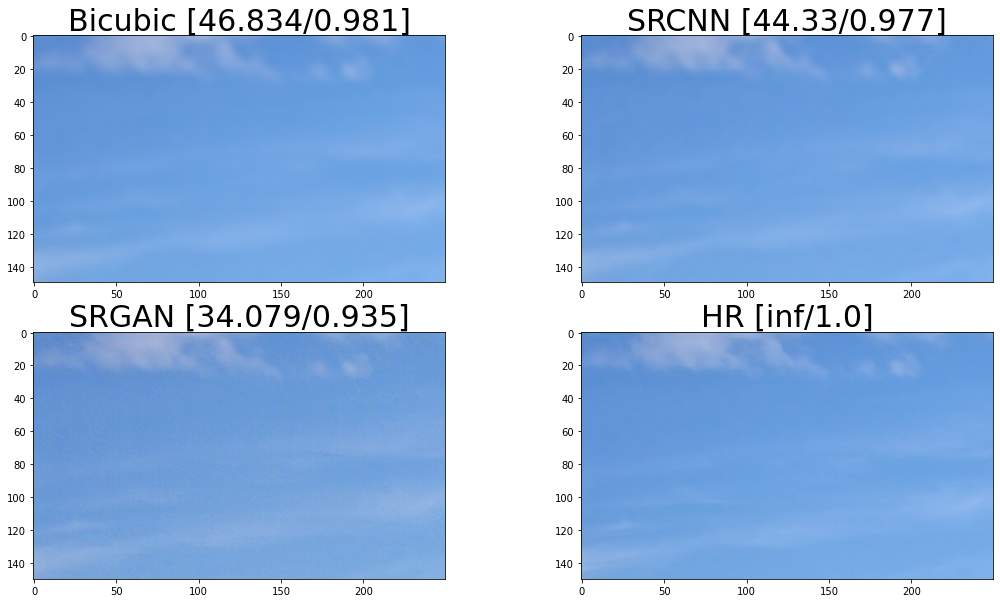

In [ ]:
for i, (lr, hr) in enumerate(valid):
    # 불러올 이미지의 인덱스를 지정합니다.
    # 위에서 시각화 했던 8, 12, 15, 24 번을 제외한 다른 숫자를 넣어봅시다 
    if i == 9: 
        break          

lr_img, hr_img = np.array(lr), np.array(hr)
bicubic_img = cv2.resize(
    lr_img,
    (hr.shape[1], hr.shape[0]),
    interpolation=cv2.INTER_CUBIC
)

# 확대할 부분의 왼쪽 상단 좌표를 지정합니다.
left_top = (100, 200)

# crop 함수 내의 세번째 네번째 인자를 수정해 이미지 크기를 조절합니다.
crop_images = [crop(i, left_top, 150, 250) for i in images] 
titles = ["Bicubic", "SRCNN", "SRGAN", "HR"]

psnr = [round(peak_signal_noise_ratio(crop_images[-1], i), 3) for i in crop_images]
ssim = [round(structural_similarity(crop_images[-1], i, multichannel=True), 3) for i in crop_images]

plt.figure(figsize=(18,10)) # 이미지 크기를 조절할 수 있습니다.
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.imshow(crop_images[i])
    plt.title(titles[i] + f" [{psnr[i]}/{ssim[i]}]", fontsize=30)

16-13. 학습한 내용 정리하기

드디어 마지막 학습 단계입니다!😆

지금까지 Super Resolution이 무엇인지, 어떻게 활용되는지, 어떠한 딥러닝 기반 연구가 있었는지에 대해 알아보며 꽤나 먼 길을 걸어왔습니다. 몇 가지 Super Resolution과 관련된 추가적인 정보들을 가볍게 읽어보고, 마지막으로 걸어온 길을 한번 뒤 돌아보며 학습했던 내용에 대해 정리해 보겠습니다.


다른 이미지를 참고한다면..?
이번에는 지금까지 학습한 Super Resolution 방법과는 약간 다른 유형의 방법에 대해 짧게 소개만 드리고 넘어가겠습니다.

이전에 학습했던 Super Resolution 방법들은 세부적으로 SISR(Single Image Super Resolution) 방법에 속합니다. 단어 뜻 그대로 한 장의 저해상도 이미지를 이용해 고해상도 이미지를 생성한다는 말입니다. 만약 여러 장의 저해상도 이미지를 잘 활용해 고해상도 이미지를 생성한다면 더 좋은 결과를 얻을 수 있지 않을까요??

RefSR(Reference-based Super Resolution)은 이러한 질문에 답이 될 수 있는 방법 중 하나입니다. 모델이 저해상도 이미지만을 받아서 고해상도 이미지를 생성하는 것이 아니라, 해상도를 높이는 데 참고할 만한 다른 이미지를 같이 제공해 주는 것이죠.

이런 방법을 활용한 연구 중 'Image Super-Resolution by Neural Texture Transfer' 논문에서 제안한 방법을 사용하면 아래 그림과 같이 매우 선명한 고해상도 이미지를 얻을 수 있습니다. Ref images라고 나타난 두 이미지를 입력으로 Super Resolution을 수행했으며, SRNTT라고 나타난 결과를 보면 이전에 학습했던 SRGAN 보다 훨씬 더 선명한 것을 확인할 수 있습니다!

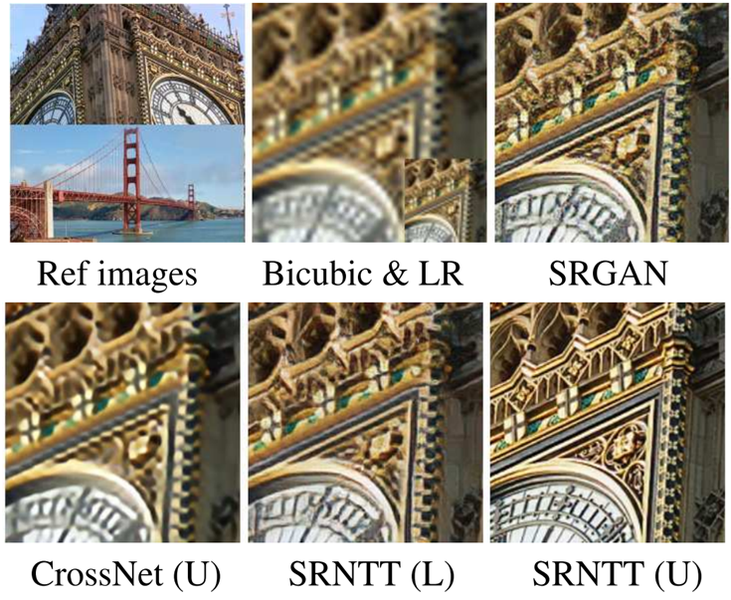
[출처: https://openaccess.thecvf.com/content_CVPR_2019/papers/Zhang_Image_Super-Resolution_by_Neural_Texture_Transfer_CVPR_2019_paper.pdf]
이러한 방법에 대해 자세히 알아보기엔 추가적으로 알아야 할 다른 많은 개념을 필요하므로 이번 학습에서 다루지는 않습니다. 위와 같이 여러 개의 저해상도 이미지를 사용해 더 좋은 품질의 고해상도 이미지를 생성하려는 연구 또한 활발히 진행되고 있으며, Super Resolution에 관심이 있다면 꼭 찾아서 공부해 볼 만한 매력적인 방법입니다.


차별을 재생성하는 인공지능
인공지능이 가진 문제들 중 하나는 차별에 관한 것입니다. 인공지능 학습에 가장 중요한 영향을 주는 몇 가지 요인들 중 하나는 학습에 사용하는 데이터이며, 이러한 데이터가 편향(bias)을 담고 있다면 그로부터 학습된 인공지능은 아무렇지도 않게 차별을 하게 됩니다.

예를 들면 아마존이 개발한 인공지능 채용/인사 시스템이 여성에 대해 편견을 가지고 있다는 성차별적 사례가 있었고, 구글의 이미지 인식 모델이 아래 그림과 같이 손의 피부색에 따라 체온계를 총으로 인식하는 인종차별적 사례가 있었습니다 (백인과 달리 흑인의 손에는 총을 들고 있다고 인식하네요..😦

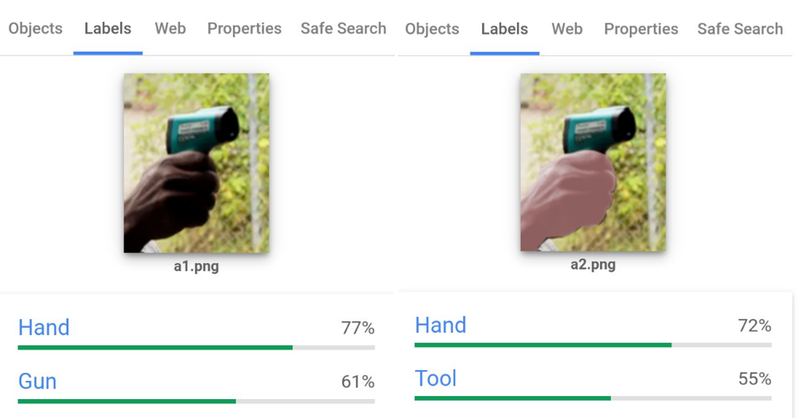

[출처: https://twitter.com/bjnagel/status/1245300089226174465?s=20]
뜬금없이 차별에 대한 얘기를 꺼낸 이유는 오늘 우리가 학습한 Super Resolution 문제에서도 이러한 차별 사례가 있기 때문입니다. 문제가 된 방법은 2020년 초에 발표된 PULSE 라는 구조입니다. 우선 이 방법은 아래 그림과 같이 Super Resolution 문제에서 매우 좋은 성능을 갖습니다. 저해상도 이미지 내에 거의 없는 정보를 완전히 새롭게 생성하는 수준이죠.
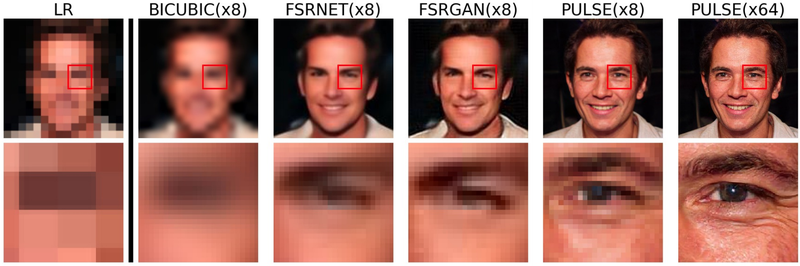

[출처: https://arxiv.org/pdf/2003.03808.pdf]
문제는 저해상도의 얼굴 이미지를 입력했을 때, 모두 백인으로 만들어 낸다는 것입니다. 아래 첫 번째 그림의 저해상도 이미지는 오바마 전 미국 대통령으로 보이는데, 이를 고해상도로 생성했을 때 결과 이미지로 백인이 등장합니다. 저해상도 입력 이미지로 동양인이나 캐릭터를 넣어도 마찬가지로 백인이 생성됨을 아래 그림으로 확인할 수 있습니다.

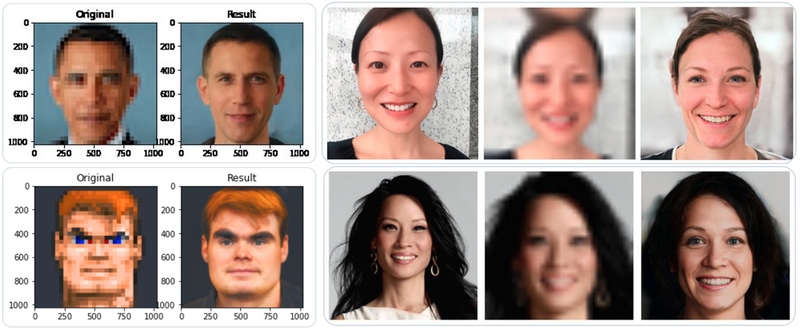
[출처: https://www.theverge.com/21298762/face-depixelizer-ai-machine-learning-tool-pulse-stylegan-obama-biashttps://www.theverge.com/21298762/face-depixelizer-ai-machine-learning-tool-pulse-stylegan-obama-bias)]
PULSE 의 연구자들은 이러한 현상이 학습했던 데이터셋에서 기인한 것이라 말했습니다. 백인 위주로 구성된 학습된 데이터로 인해 저해상도 얼굴 이미지에서 만들어야 할 새로운 픽셀들이 기본적으로 흰색에 가깝게 설정되거나, 백인과 비슷한 이목구비가 형성되는 것이죠. 어쩌면 백인들이 전 세계 인공지능 연구의 꽤 많은 부분을 차지하고 있기 때문에 이러한 결과가 자연스러운 것 같기도 합니다.

이렇게 인공지능에서 나타나는 차별을 줄이고 누구에게나 공정한 인공지능 시스템을 설계하기 위한 연구가 활발하게 진행되고 있습니다. 이에 대해 관심이 있다면 아래 링크를 읽어보시길 추천해 드립니다!

참고 자료: 공정한 AI 얼굴인식기


학습한 내용 정리하기
아래 참고 자료는 전반적인 Super Resolution에 대해 잘 설명한 글입니다. 이를 읽고 문제에 답하면서 오늘 학습했던 내용에 대해 정리해보겠습니다.

참고 자료: Single Image Super Resolution using Deep Learning Overview

Q12. 저해상도 이미지를 고해상도로 복원할 때, 고해상도 이미지의 정답이 여러 개 존재할 수 있는데 이러한 문제를 무엇이라고 하나요?

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
Q13. Interpolation을 활용해 Super Resolution을 할 때 사용할 수 있는 방법 2가지만 적어주세요.

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
Q14. SRCNN과 VDSR은 각각 몇 개의 convolutional layer를 사용하나요?

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
Q15. GAN을 이용한 Super Resolution에서 Generator의 역할은 무엇인가요?

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
Q16. 참고 자료에서 SRGAN의 Perceptual Loss를 구성하는 두 가지 loss는 무엇이라고 했나요?

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
Q17. 많은 Super Resolution 논문에서 사용하는 두 가지 정량적 성능 지표는 무엇인가요?

정답을 입력하신 뒤 예시답안 버튼을 눌러주세요.
추가 학습 자료
이번 학습을 통해 Super Resolution 문제를 해결하는데 흥미가 생겼다면, 아래 영상 자료를 통해 여기서 다루지 못한 자세한 내용을 학습해 보세요. SRGAN의 경우 모두의연구소 김승일 소장님께서 직접 설명해 주십니다😆

참고 자료: PR12 - SRCNN
참고 자료: PR12 - SRGAN
참고 자료: EDSR
참고 자료: 딥러닝 Super Resolution 어디까지 왔니?